In [1]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# 1. 

In [2]:
dtype = dict()
dtype.update({
    x : 'category'
    for x in ['image_id', 'class_name', 'class_id', 'rad_id']
})
data = pd.read_csv('data/train.csv', dtype=dtype)
data.head()

,image_id,class_name,class_id,rad_id,x_min,y_min,x_max,y_max,width,height
0,50a418190bc3fb1ef1633bf9678929b3,No finding,14,R11,NaN,NaN,NaN,NaN,2332,2580
1,21a10246a5ec7af151081d0cd6d65dc9,No finding,14,R7,NaN,NaN,NaN,NaN,2954,3159
2,9a5094b2563a1ef3ff50dc5c7ff71345,Cardiomegaly,3,R10,691.0,1375.0,1653.0,1831.0,2080,2336
3,051132a778e61a86eb147c7c6f564dfe,Aortic enlargement,0,R10,1264.0,743.0,1611.0,1019.0,2304,2880
4,063319de25ce7edb9b1c6b8881290140,No finding,14,R10,NaN,NaN,NaN,NaN,2540,3072


In [7]:
print('Number of bounding boxes:', len(data))
print('Number of images:', len(data['image_id'].unique()))
print('Number of classes:', len(data['class_id'].unique()))
print('Number of radiologists:', len(data['rad_id'].unique()))

Number of bounding boxes: 67914
Number of images: 15000
Number of classes: 15
Number of radiologists: 17


In [3]:
data.x_min /= data.width
data.x_max /= data.width
data.y_min /= data.height
data.y_max /= data.height
data.head()

,image_id,class_name,class_id,rad_id,x_min,y_min,x_max,y_max,width,height
0,50a418190bc3fb1ef1633bf9678929b3,No finding,14,R11,NaN,NaN,NaN,NaN,2332,2580
1,21a10246a5ec7af151081d0cd6d65dc9,No finding,14,R7,NaN,NaN,NaN,NaN,2954,3159
2,9a5094b2563a1ef3ff50dc5c7ff71345,Cardiomegaly,3,R10,0.332212,0.588613,0.794712,0.783818,2080,2336
3,051132a778e61a86eb147c7c6f564dfe,Aortic enlargement,0,R10,0.548611,0.257986,0.699219,0.353819,2304,2880
4,063319de25ce7edb9b1c6b8881290140,No finding,14,R10,NaN,NaN,NaN,NaN,2540,3072


In [4]:
data['bbox_area'] = (data.x_max - data.x_min) * (data.y_max - data.y_min)
data.head()

,image_id,class_name,class_id,rad_id,x_min,y_min,x_max,y_max,width,height,bbox_area
0,50a418190bc3fb1ef1633bf9678929b3,No finding,14,R11,NaN,NaN,NaN,NaN,2332,2580,NaN
1,21a10246a5ec7af151081d0cd6d65dc9,No finding,14,R7,NaN,NaN,NaN,NaN,2954,3159,NaN
2,9a5094b2563a1ef3ff50dc5c7ff71345,Cardiomegaly,3,R10,0.332212,0.588613,0.794712,0.783818,2080,2336,0.090283
3,051132a778e61a86eb147c7c6f564dfe,Aortic enlargement,0,R10,0.548611,0.257986,0.699219,0.353819,2304,2880,0.014433
4,063319de25ce7edb9b1c6b8881290140,No finding,14,R10,NaN,NaN,NaN,NaN,2540,3072,NaN


In [9]:
df_imageid_classid = data[['image_id', 'class_id']].groupby('image_id').describe()

In [10]:
df_imageid_classid.head()

class_id                
                                    count unique top freq
image_id                                                 
000434271f63a053c4128a0ba6352c7f        3      1  14    3
00053190460d56c53cc3e57321387478        3      1  14    3
0005e8e3701dfb1dd93d53e2ff537b6e        5      4   7    2
0006e0a85696f6bb578e84fafa9a5607        3      1  14    3
0007d316f756b3fa0baea2ff514ce945       11      5  11    3

In [11]:
data[['class_id', 'rad_id']].groupby('class_id').describe()

rad_id                  
          count unique  top  freq
class_id                         
0          7162     10   R9  2541
1           279     10  R10   115
10         2476     10   R9  1045
11         4842     10   R9  2466
12          226      8   R9    75
13         4655     10   R9  1757
14        31818     17   R2  3118
2           960     11   R8   321
3          5427     10  R10  1835
4           556      9   R8   228
5          1000     11   R8   303
6          1247      9   R9   439
7          2483     10   R9  1042
8          2580     10  R10   866
9          2203     10   R9   971

In [12]:
data[['class_id', 'rad_id']].groupby('rad_id').describe()

class_id                 
          count unique top  freq
rad_id                          
R1         1995      1  14  1995
R10       13292     15   0  2349
R11        1670     14  14  1413
R12        1729     15  14  1580
R13        1824     15  14  1505
R14        1624     15  14  1300
R15        1823     14  14  1508
R16        1763     15  14  1565
R17         812     13  14   743
R2         3121      3  14  3118
R3         2285      1  14  2285
R4         1513      1  14  1513
R5         2783      1  14  2783
R6         2041      1  14  2041
R7         1733      1  14  1733
R8        12198     15  14  2436
R9        15708     15   0  2541

In [13]:
data[['class_id', 'x_min']].groupby('class_id').describe()

x_min                                                              \
           count      mean       std       min       25%       50%       75%   
class_id                                                                       
0         7162.0  0.505262  0.043235  0.263889  0.485243  0.509679  0.532227   
1          279.0  0.355440  0.214749  0.029514  0.189636  0.272461  0.562713   
10        2476.0  0.371303  0.331343  0.000000  0.086903  0.155273  0.749051   
11        4842.0  0.413091  0.260603  0.000000  0.201856  0.323553  0.621962   
12         226.0  0.287720  0.240185  0.015191  0.095537  0.161992  0.553397   
13        4655.0  0.411160  0.239938  0.019965  0.199427  0.299366  0.649230   
14           0.0       NaN       NaN       NaN       NaN       NaN       NaN   
2          960.0  0.478485  0.227819  0.003439  0.239245  0.552057  0.660206   
3         5427.0  0.357234  0.044749  0.181517  0.329132  0.358887  0.385429   
4          556.0  0.346466  0.214663  0.037760  0.177592  0.260336  0.585343   
5         1000.0  0.390552  0.249572  0.021267  0.148470  0.274089  0.629693   
6         1247.0  0.380056  0.229271  0.035156  0.180604  0.263000  0.618869   
7         2483.0  0.372505  0.236066  0.000434  0.172532  0.275862  0.610250   
8         2580.0  0.450568  0.249226  0.004812  0.226730  0.352007  0.699151   
9         2203.0  0.385265  0.252783  0.000000  0.166441  0.353937  0.603738   

                    
               max  
class_id            
0         0.658854  
1         0.914941  
10        0.969238  
11        0.969238  
12        0.873857  
13        0.918403  
14             NaN  
2         0.912113  
3         0.695462  
4         0.862305  
5         0.899691  
6         0.900174  
7         0.906109  
8         0.928696  
9         0.964410

Class 0


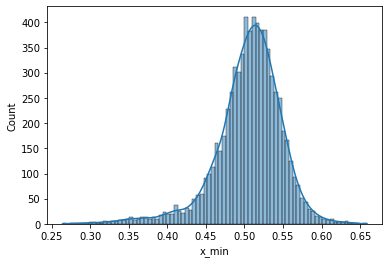

Class 1


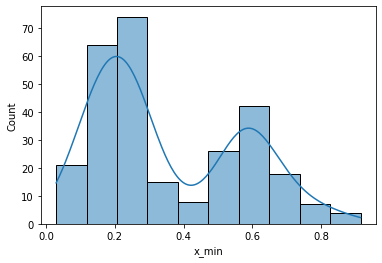

Class 2


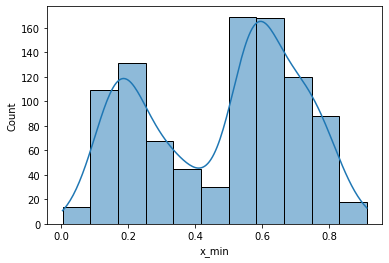

Class 3


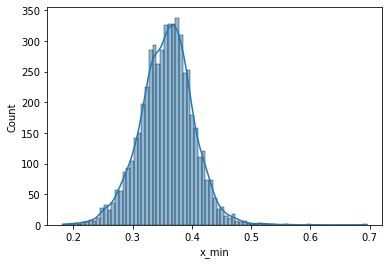

Class 4


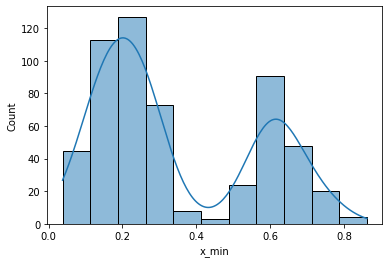

Class 5


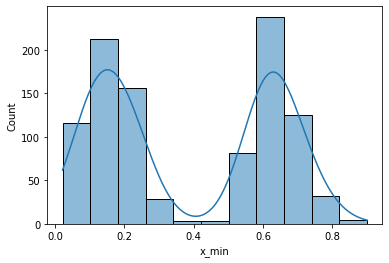

Class 6


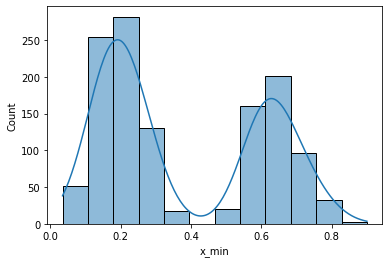

Class 7


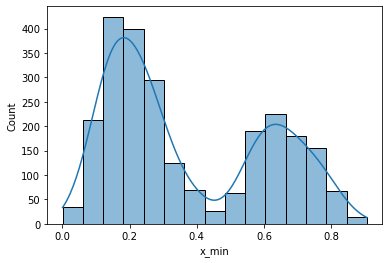

Class 8


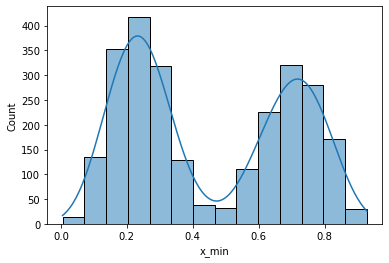

Class 9


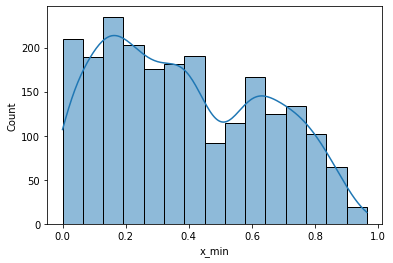

Class 10


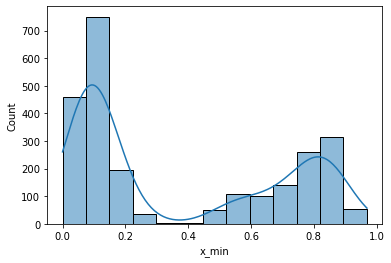

Class 11


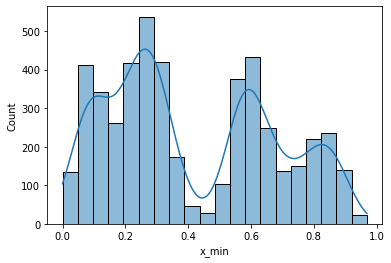

Class 12


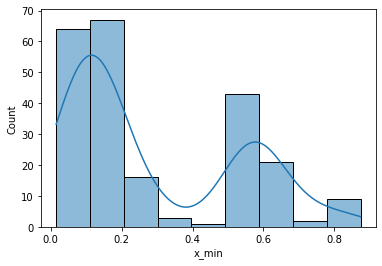

Class 13


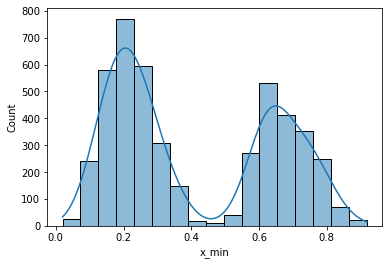

In [40]:
for i in range(14):
    print('Class', i)
    sns.histplot(data[data['class_id'] == f'{i}'].x_min, kde=True)
    plt.show()

In [14]:
data[['class_id', 'x_max']].groupby('class_id').describe()

x_max                                                              \
           count      mean       std       min       25%       50%       75%   
class_id                                                                       
0         7162.0  0.629847  0.038254  0.415365  0.606924  0.631507  0.653696   
1          279.0  0.566121  0.208242  0.212674  0.410896  0.459661  0.780339   
10        2476.0  0.517982  0.325020  0.030816  0.191369  0.432404  0.874535   
11        4842.0  0.517601  0.259806  0.030816  0.332384  0.448422  0.754491   
12         226.0  0.550210  0.221374  0.137692  0.410954  0.458284  0.810692   
13        4655.0  0.540233  0.232713  0.069824  0.346831  0.431929  0.786182   
14           0.0       NaN       NaN       NaN       NaN       NaN       NaN   
2          960.0  0.562324  0.222875  0.090712  0.371498  0.613763  0.753743   
3         5427.0  0.792075  0.051208  0.532552  0.758247  0.794956  0.827404   
4          556.0  0.537886  0.208371  0.137587  0.387352  0.436429  0.761825   
5         1000.0  0.615431  0.239963  0.161328  0.394640  0.478708  0.856257   
6         1247.0  0.564852  0.222827  0.138455  0.383235  0.447591  0.802332   
7         2483.0  0.534505  0.225551  0.055556  0.360380  0.437952  0.784728   
8         2580.0  0.517578  0.249537  0.059783  0.284696  0.445020  0.761285   
9         2203.0  0.531459  0.248664  0.028653  0.343390  0.483854  0.759474   

                    
               max  
class_id            
0         0.837902  
1         0.982083  
10        0.997559  
11        0.997559  
12        0.959985  
13        0.983348  
14             NaN  
2         0.996943  
3         0.954625  
4         0.962129  
5         0.994792  
6         0.996962  
7         0.992380  
8         0.982000  
9         1.000000

Class 0


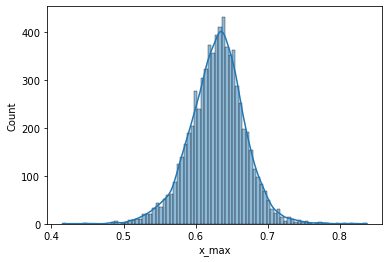

Class 1


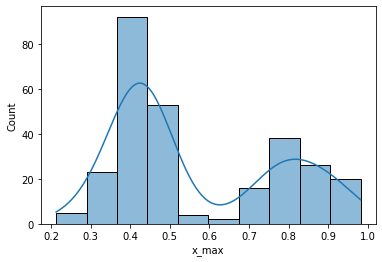

Class 2


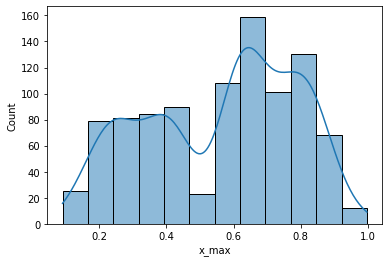

Class 3


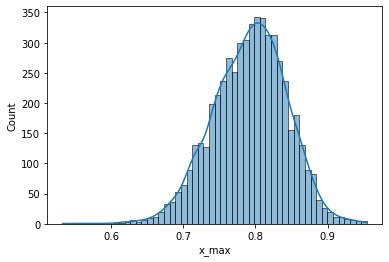

Class 4


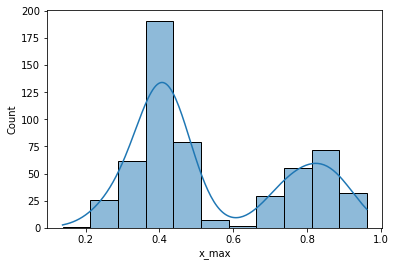

Class 5


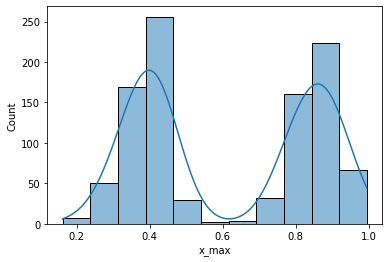

Class 6


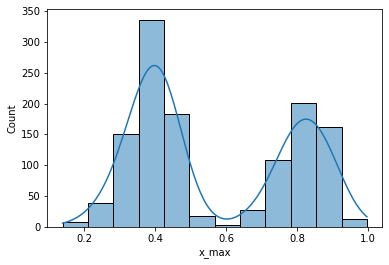

Class 7


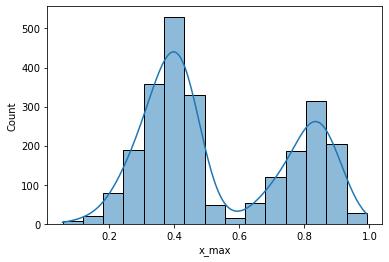

Class 8


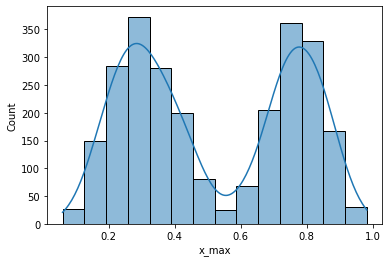

Class 9


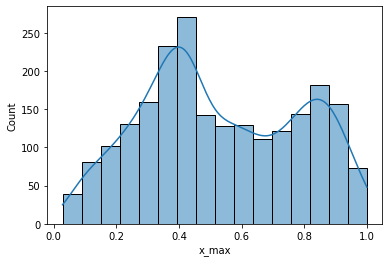

Class 10


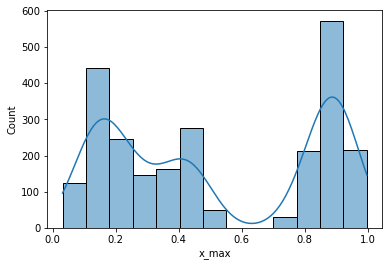

Class 11


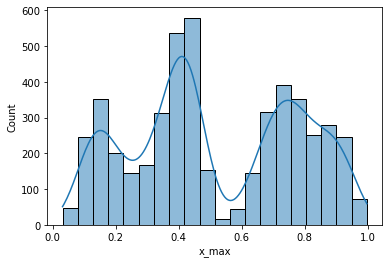

Class 12


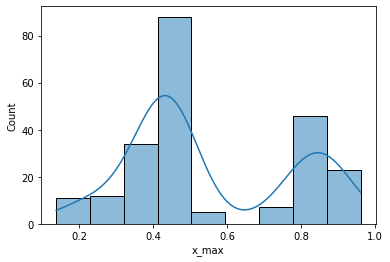

Class 13


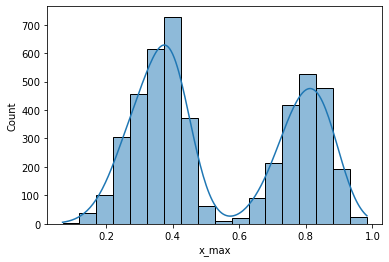

In [41]:
for i in range(14):
    print('Class', i)
    sns.histplot(data[data['class_id'] == f'{i}'].x_max, kde=True)
    plt.show()

In [15]:
data[['class_id', 'y_min']].groupby('class_id').describe()

y_min                                                              \
           count      mean       std       min       25%       50%       75%   
class_id                                                                       
0         7162.0  0.268225  0.050453  0.086000  0.235252  0.267719  0.301720   
1          279.0  0.253957  0.163714  0.027213  0.137883  0.190278  0.322954   
10        2476.0  0.576988  0.201052  0.040989  0.466912  0.609826  0.725260   
11        4842.0  0.347816  0.277772  0.010320  0.129134  0.181046  0.644911   
12         226.0  0.236347  0.176565  0.036850  0.123312  0.161558  0.252153   
13        4655.0  0.313756  0.160565  0.020339  0.186302  0.272786  0.420692   
14           0.0       NaN       NaN       NaN       NaN       NaN       NaN   
2          960.0  0.358036  0.164964  0.026000  0.236582  0.322418  0.459535   
3         5427.0  0.530675  0.074835  0.041353  0.479090  0.532400  0.583557   
4          556.0  0.336459  0.143312  0.028668  0.213037  0.318736  0.461025   
5         1000.0  0.305525  0.135897  0.021918  0.204210  0.286089  0.391995   
6         1247.0  0.299097  0.148779  0.036784  0.179190  0.264052  0.406851   
7         2483.0  0.361206  0.160544  0.032639  0.227184  0.349662  0.490041   
8         2580.0  0.415599  0.158489  0.023231  0.286963  0.398872  0.540171   
9         2203.0  0.360209  0.203169  0.000000  0.201682  0.339744  0.526326   

                    
               max  
class_id            
0         0.661337  
1         0.719970  
10        0.963619  
11        0.963619  
12        0.746931  
13        0.872186  
14             NaN  
2         0.906412  
3         0.745671  
4         0.708333  
5         0.768968  
6         0.779135  
7         0.849368  
8         0.900836  
9         0.897820

Class 0


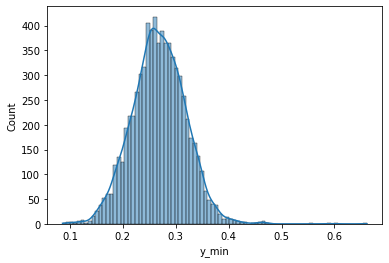

Class 1


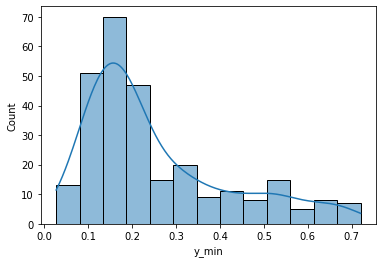

Class 2


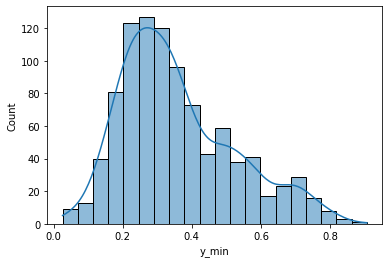

Class 3


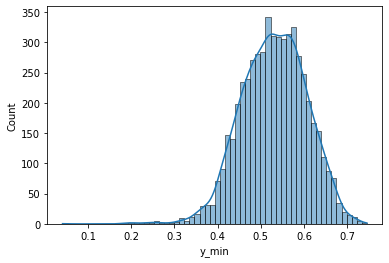

Class 4


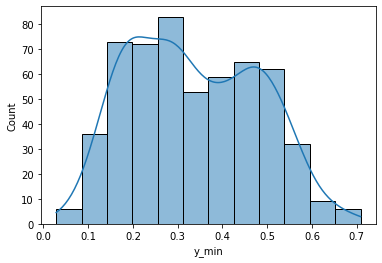

Class 5


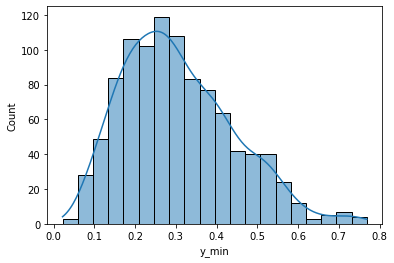

Class 6


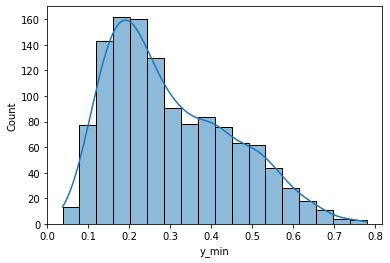

Class 7


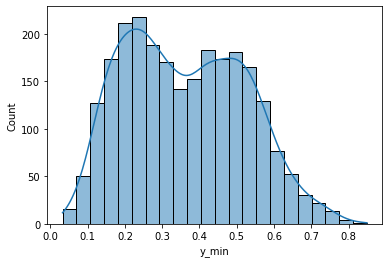

Class 8


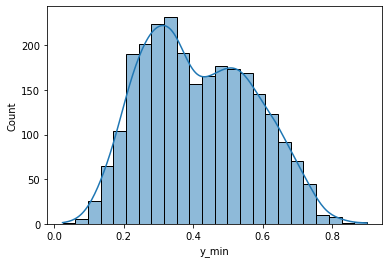

Class 9


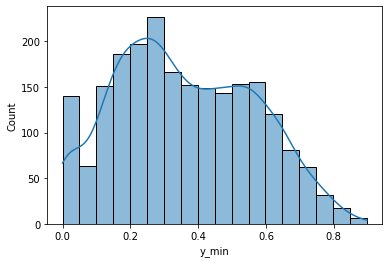

Class 10


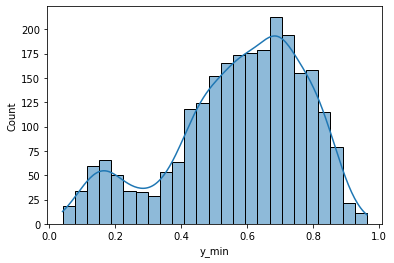

Class 11


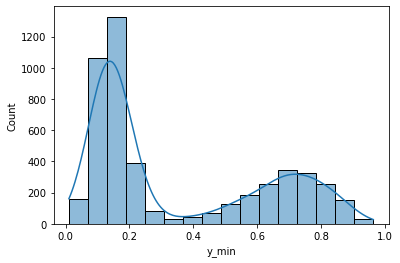

Class 12


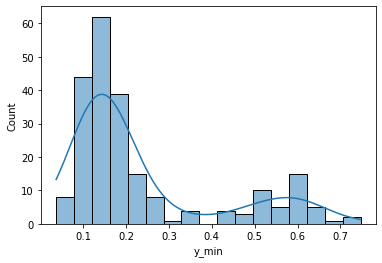

Class 13


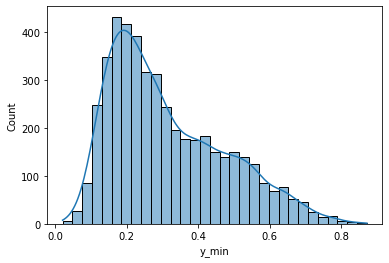

In [42]:
for i in range(14):
    print('Class', i)
    sns.histplot(data[data['class_id'] == f'{i}'].y_min, kde=True)
    plt.show()

In [16]:
data[['class_id', 'y_max']].groupby('class_id').describe()

y_max                                                              \
           count      mean       std       min       25%       50%       75%   
class_id                                                                       
0         7162.0  0.389829  0.061661  0.182986  0.349306  0.388542  0.428739   
1          279.0  0.473891  0.179846  0.175336  0.328681  0.431071  0.620099   
10        2476.0  0.746832  0.108263  0.145401  0.673234  0.748005  0.822224   
11        4842.0  0.416825  0.290648  0.034288  0.175784  0.244444  0.727035   
12         226.0  0.587515  0.215103  0.123746  0.389323  0.623958  0.775130   
13        4655.0  0.434825  0.150556  0.109028  0.322917  0.409908  0.529305   
14           0.0       NaN       NaN       NaN       NaN       NaN       NaN   
2          960.0  0.453631  0.164099  0.081200  0.337802  0.410877  0.568205   
3         5427.0  0.672523  0.087233  0.054825  0.610784  0.673713  0.735683   
4          556.0  0.538448  0.139459  0.205208  0.426762  0.538530  0.641945   
5         1000.0  0.664106  0.120875  0.116536  0.590251  0.671236  0.754568   
6         1247.0  0.512928  0.156378  0.167361  0.389582  0.505150  0.636555   
7         2483.0  0.531973  0.163512  0.088055  0.404399  0.546875  0.657383   
8         2580.0  0.484919  0.159100  0.084961  0.358952  0.482287  0.606255   
9         2203.0  0.546542  0.220128  0.079514  0.372247  0.566081  0.713280   

                    
               max  
class_id            
0         0.785354  
1         0.894772  
10        0.997512  
11        0.997512  
12        0.998188  
13        0.940916  
14             NaN  
2         0.944587  
3         0.945862  
4         0.899283  
5         0.933894  
6         0.945312  
7         0.967844  
8         0.948228  
9         1.000000

Class 0


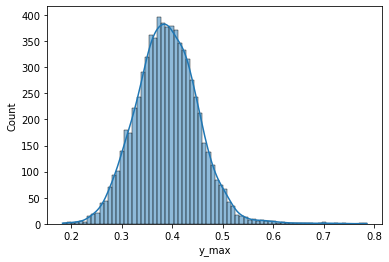

Class 1


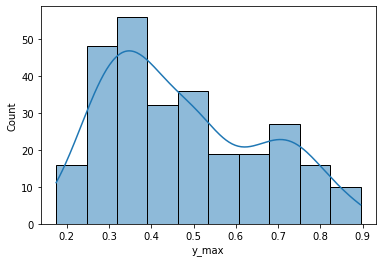

Class 2


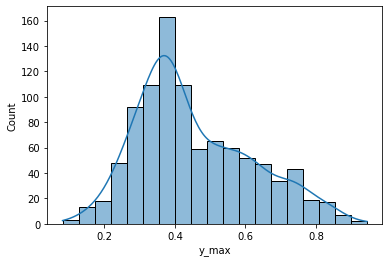

Class 3


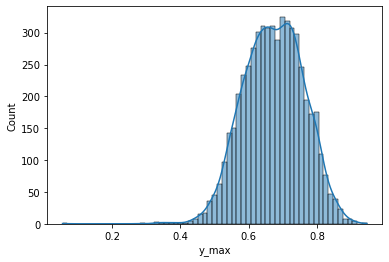

Class 4


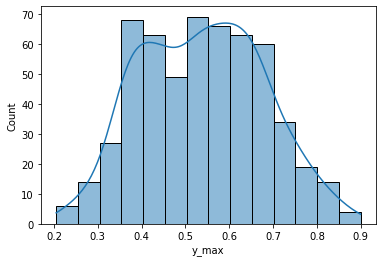

Class 5


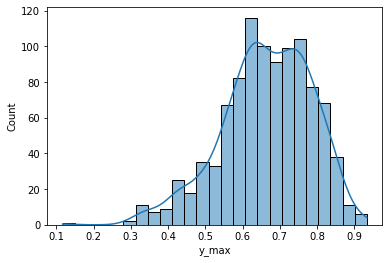

Class 6


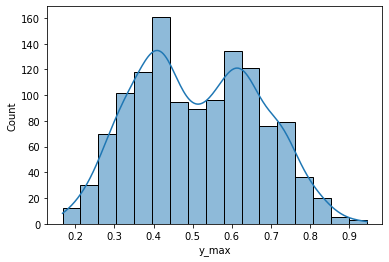

Class 7


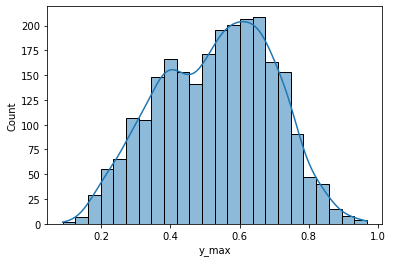

Class 8


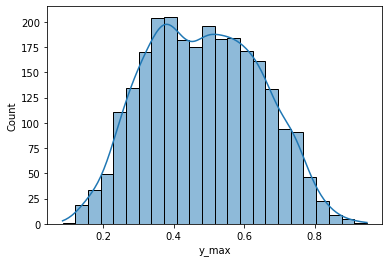

Class 9


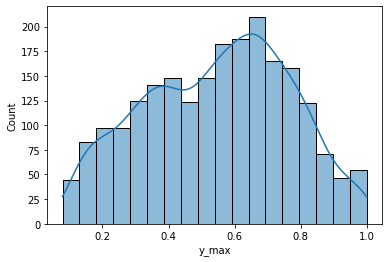

Class 10


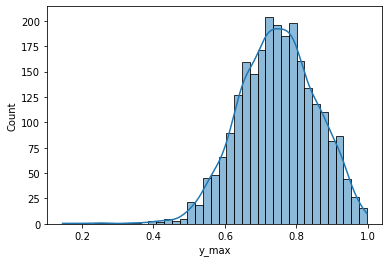

Class 11


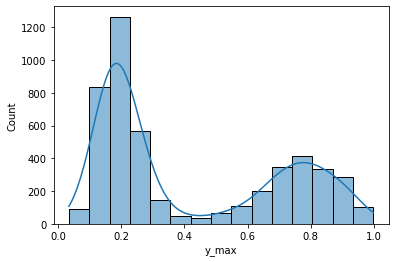

Class 12


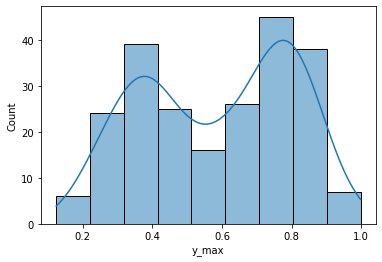

Class 13


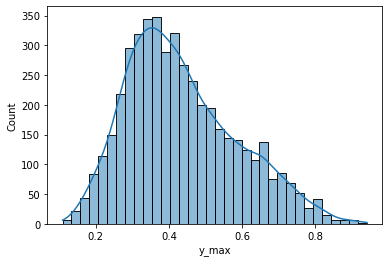

In [43]:
for i in range(14):
    print('Class', i)
    sns.histplot(data[data['class_id'] == f'{i}'].y_max, kde=True)
    plt.show()

In [21]:
data[['class_id', 'bbox_area']].groupby('class_id').describe()

bbox_area                                                    \
             count      mean       std       min       25%       50%   
class_id                                                               
0           7162.0  0.016004  0.010890  0.003452  0.010602  0.013687   
1            279.0  0.053384  0.054472  0.001431  0.019746  0.037412   
10          2476.0  0.039516  0.060157  0.000053  0.003506  0.008754   
11          4842.0  0.008409  0.014422  0.000162  0.002575  0.004415   
12           226.0  0.104061  0.086010  0.002412  0.035324  0.072374   
13          4655.0  0.020247  0.025911  0.000043  0.003836  0.010590   
14             0.0       NaN       NaN       NaN       NaN       NaN   
2            960.0  0.012405  0.022001  0.000093  0.001302  0.003779   
3           5427.0  0.062641  0.025257  0.001431  0.047027  0.058274   
4            556.0  0.044359  0.038531  0.002105  0.016978  0.032295   
5           1000.0  0.089082  0.066352  0.000043  0.042246  0.073516   
6           1247.0  0.045946  0.041057  0.000781  0.016357  0.033668   
7           2483.0  0.034255  0.039672  0.000081  0.009463  0.021106   
8           2580.0  0.009908  0.026490  0.000023  0.000512  0.001375   
9           2203.0  0.036062  0.056127  0.000047  0.004350  0.016846   

                              
               75%       max  
class_id                      
0         0.017871  0.242200  
1         0.062784  0.343817  
10        0.050416  0.392123  
11        0.008128  0.219302  
12        0.167851  0.390316  
13        0.026656  0.259243  
14             NaN       NaN  
2         0.013831  0.244928  
3         0.072092  0.338311  
4         0.062551  0.312893  
5         0.120314  0.722673  
6         0.062004  0.336471  
7         0.044575  0.528434  
8         0.007149  0.629849  
9         0.046382  0.938427

Class 0


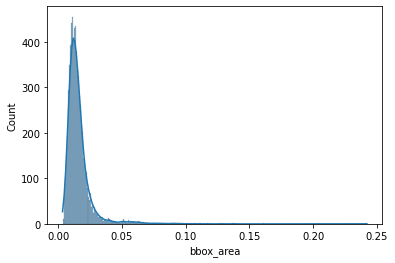

Class 1


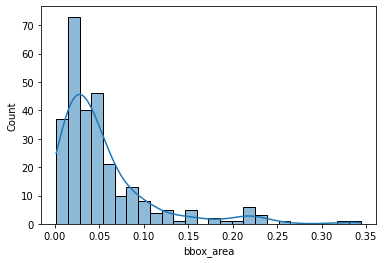

Class 2


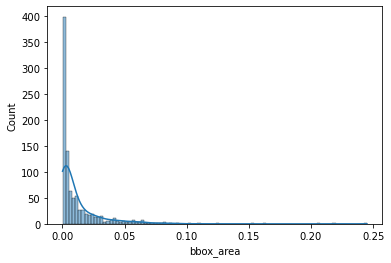

Class 3


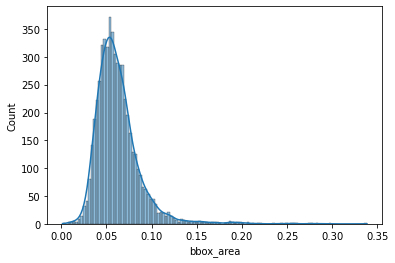

Class 4


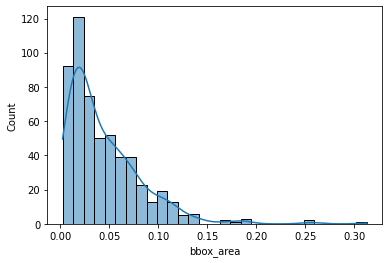

Class 5


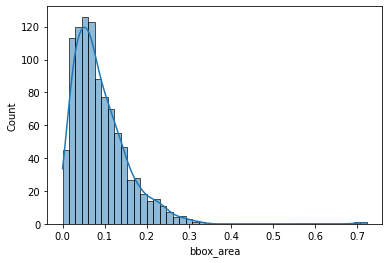

Class 6


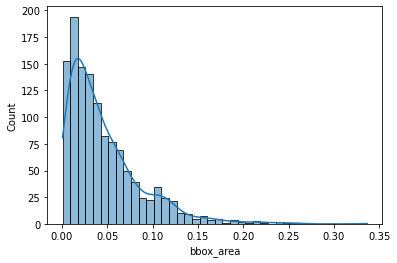

Class 7


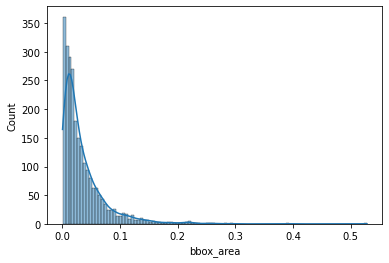

Class 8


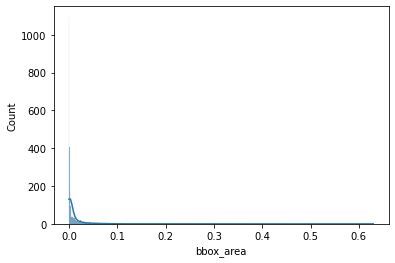

Class 9


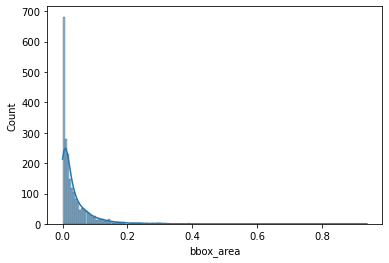

Class 10


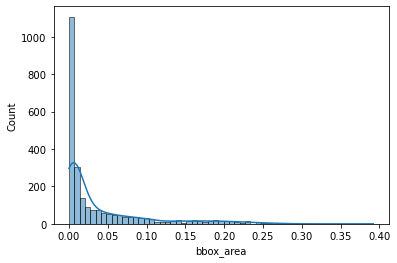

Class 11


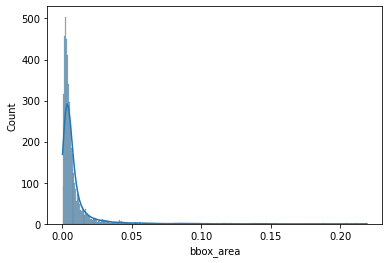

Class 12


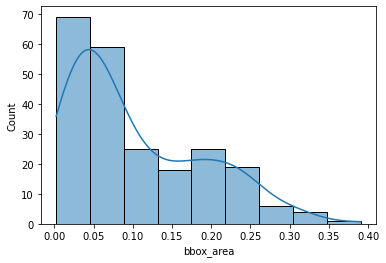

Class 13


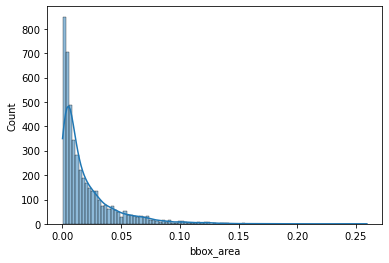

In [44]:
for i in range(14):
    print('Class', i)
    sns.histplot(data[data['class_id'] == f'{i}'].bbox_area, kde=True)
    plt.show()

Class 0


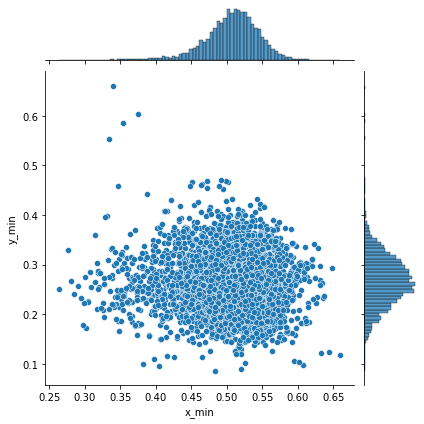

Class 1


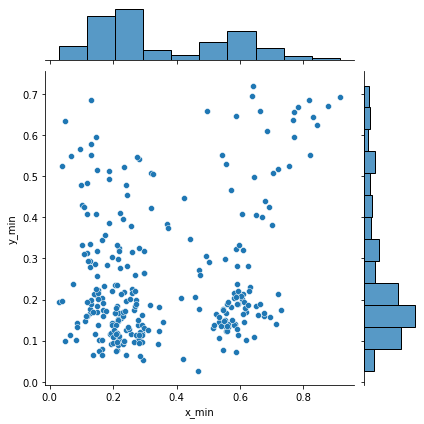

Class 2


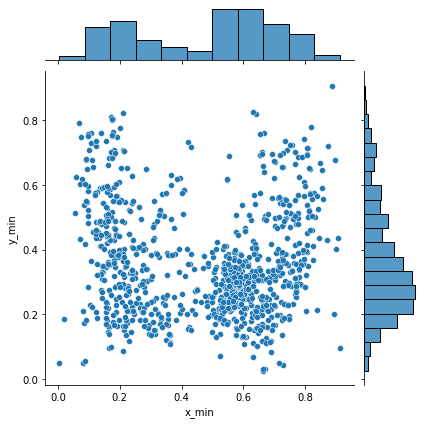

Class 3


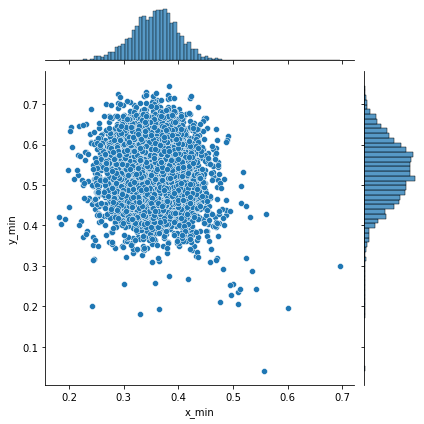

Class 4


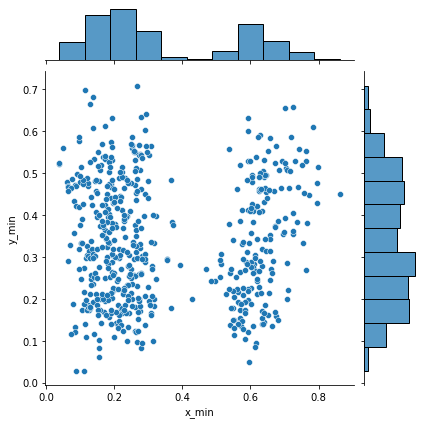

Class 5


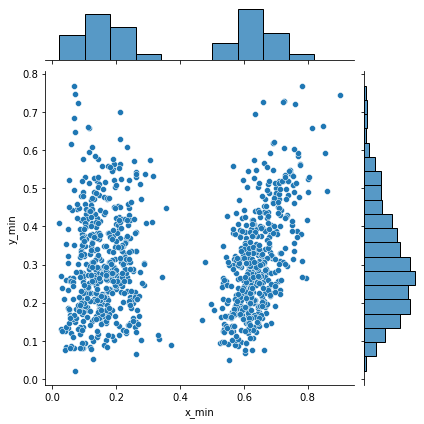

Class 6


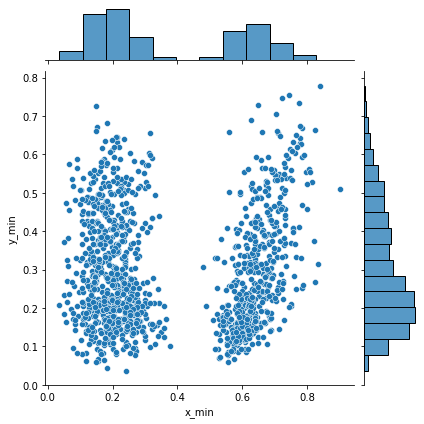

Class 7


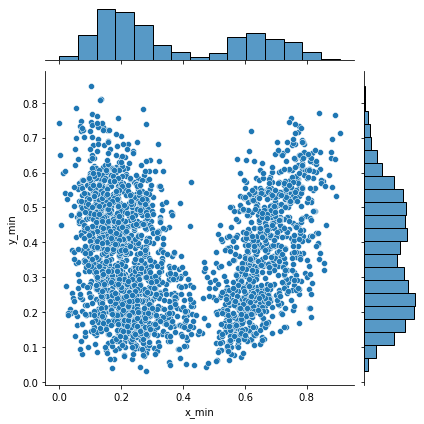

Class 8


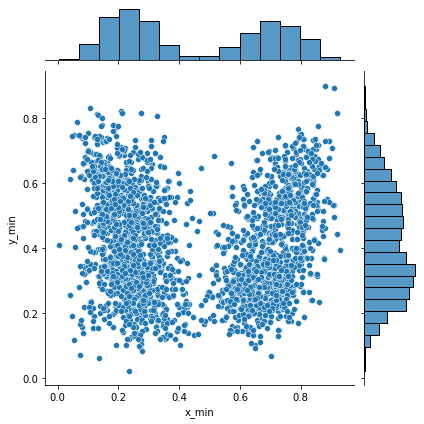

Class 9


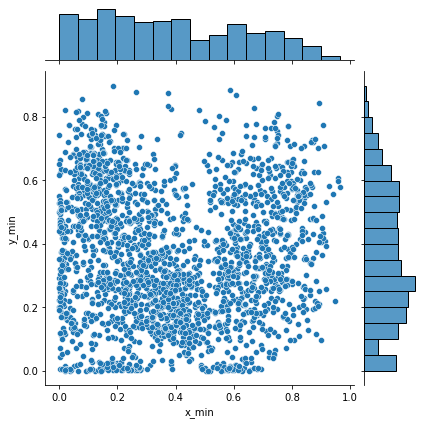

Class 10


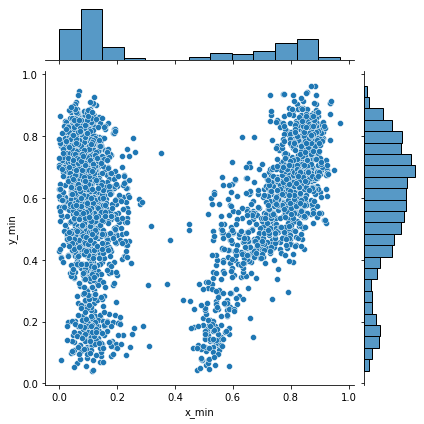

Class 11


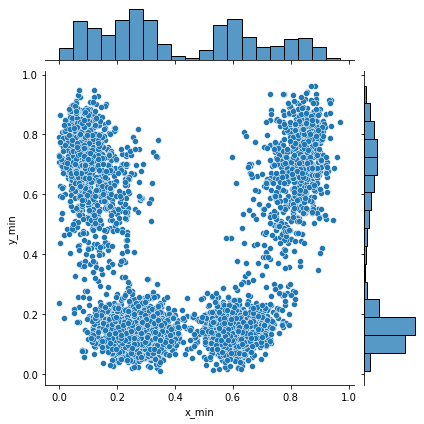

Class 12


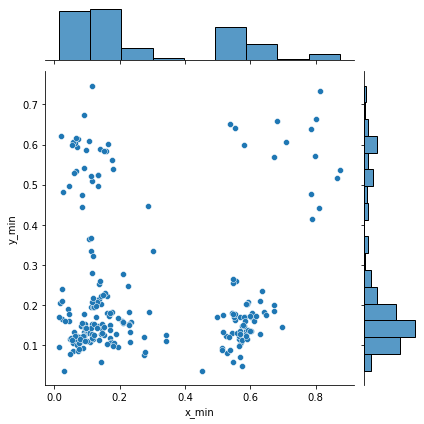

Class 13


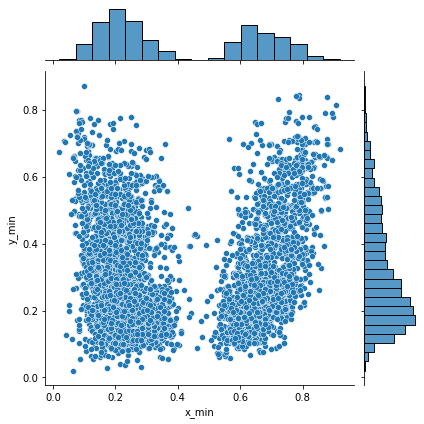

In [46]:
for i in range(14):
    print('Class', i)
    tmp = data[data['class_id'] == f'{i}']
    sns.jointplot(x=tmp.x_min, y=tmp.y_min)
    plt.show()

Class 0


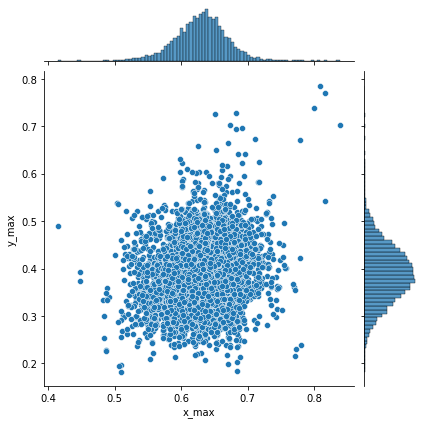

Class 1


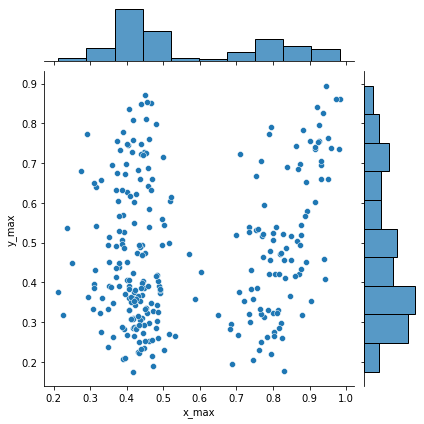

Class 2


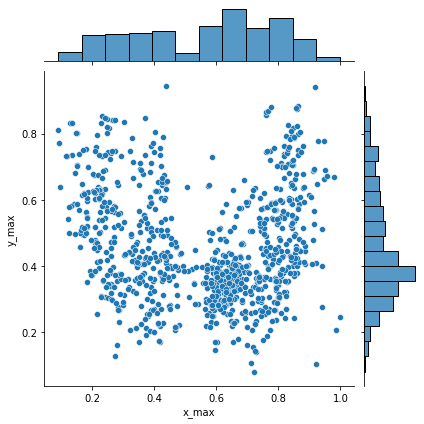

Class 3


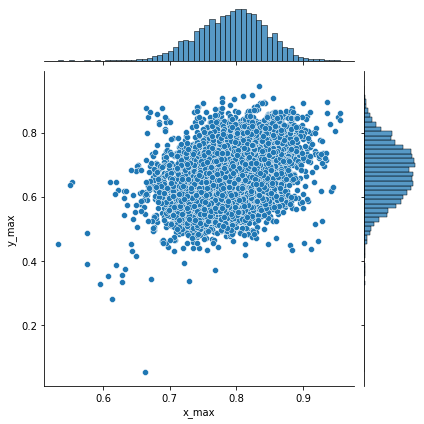

Class 4


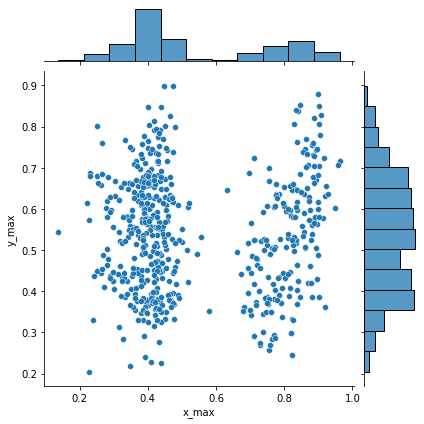

Class 5


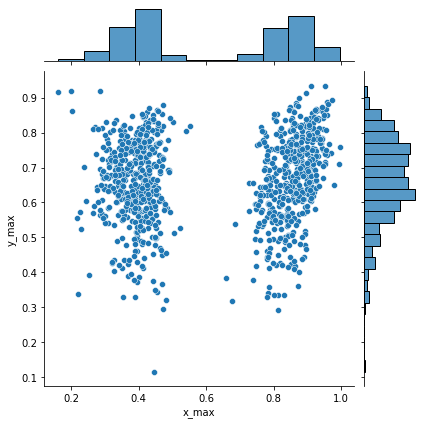

Class 6


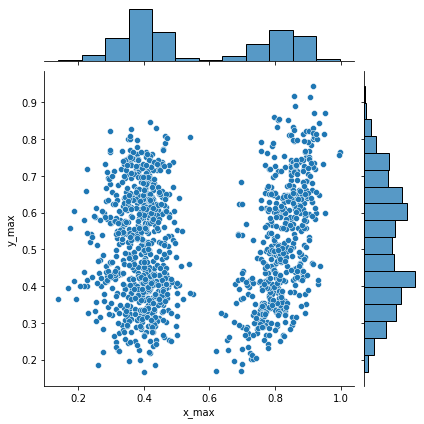

Class 7


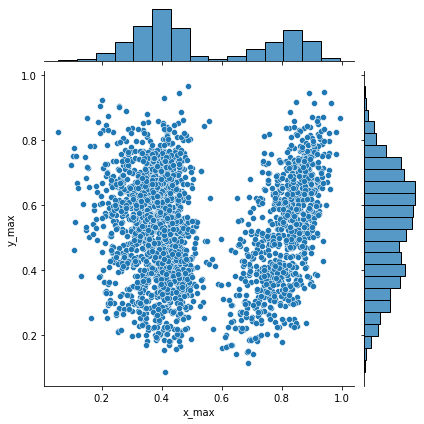

Class 8


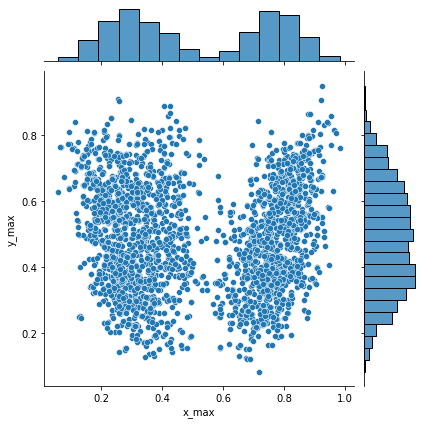

Class 9


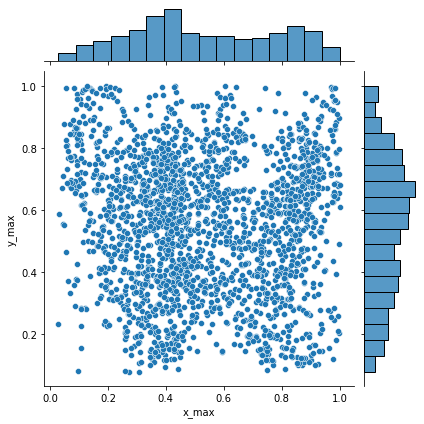

Class 10


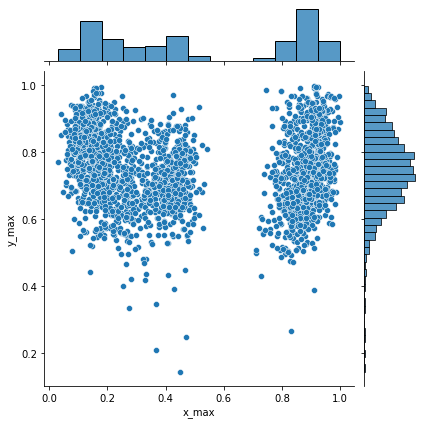

Class 11


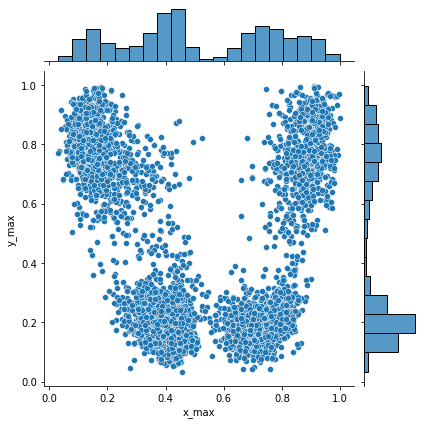

Class 12


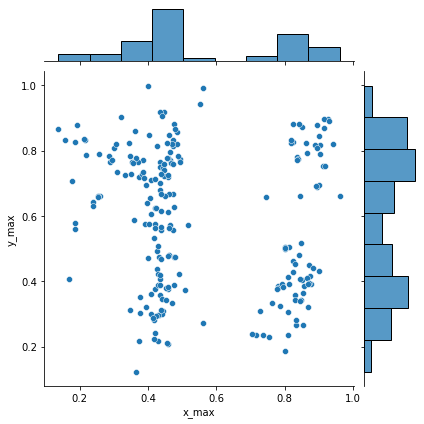

Class 13


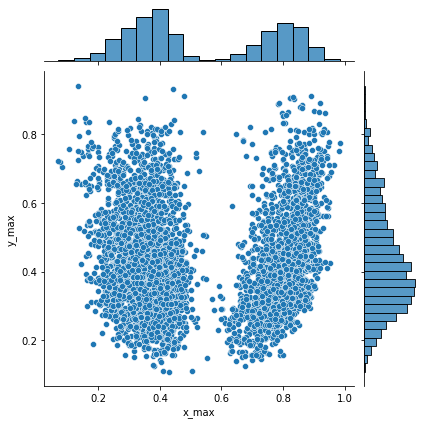

In [47]:
for i in range(14):
    print('Class', i)
    tmp = data[data['class_id'] == f'{i}']
    sns.jointplot(x=tmp.x_max, y=tmp.y_max)
    plt.show()

Class 0


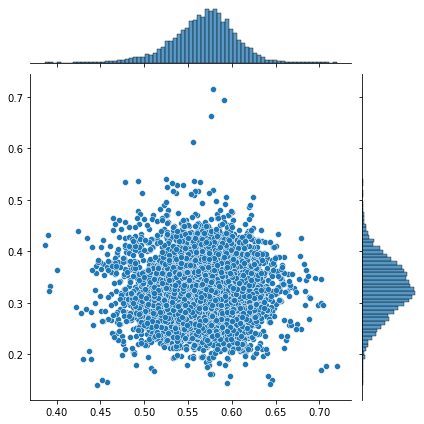

Class 1


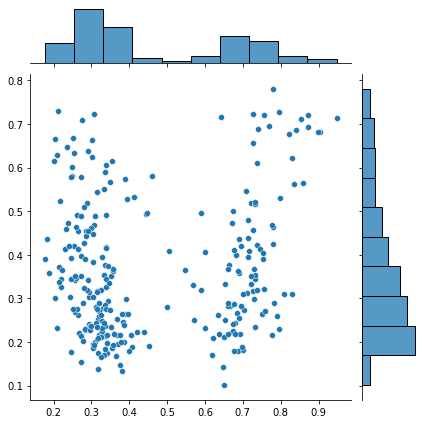

Class 2


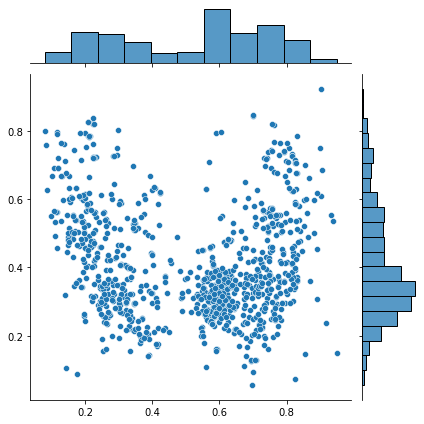

Class 3


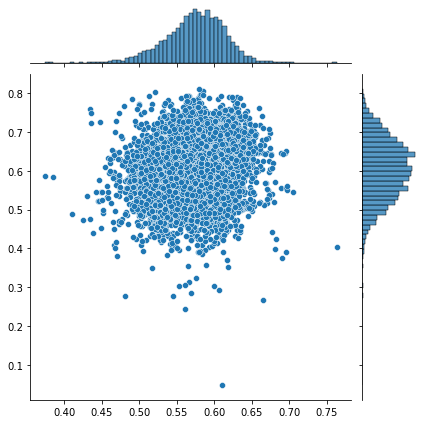

Class 4


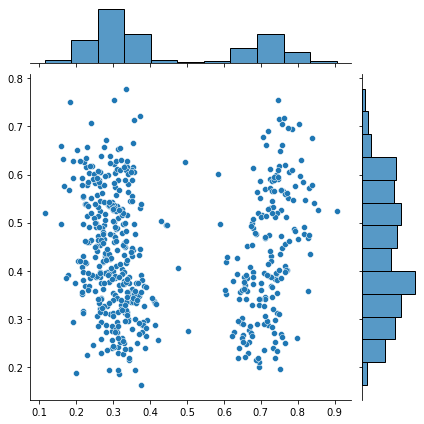

Class 5


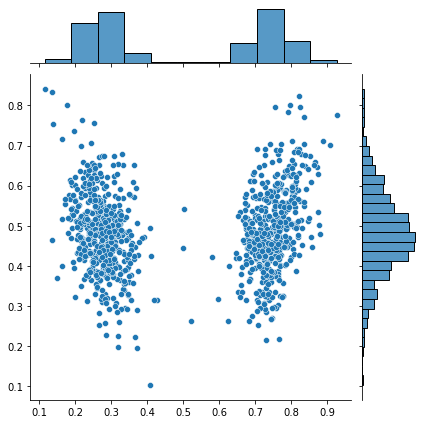

Class 6


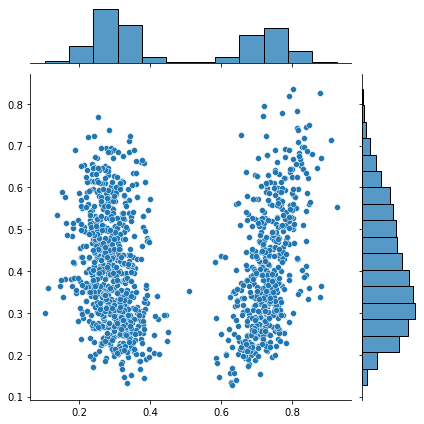

Class 7


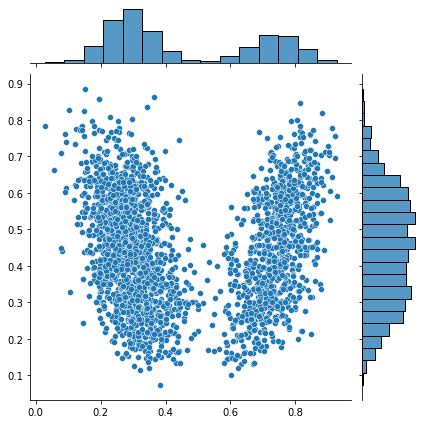

Class 8


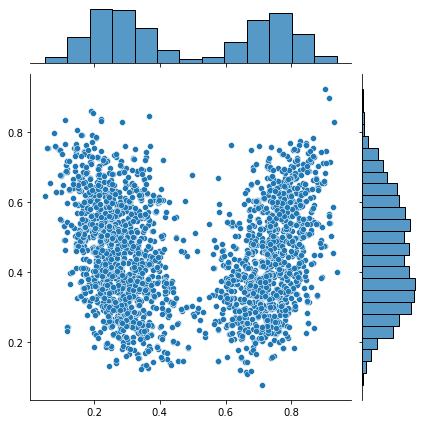

Class 9


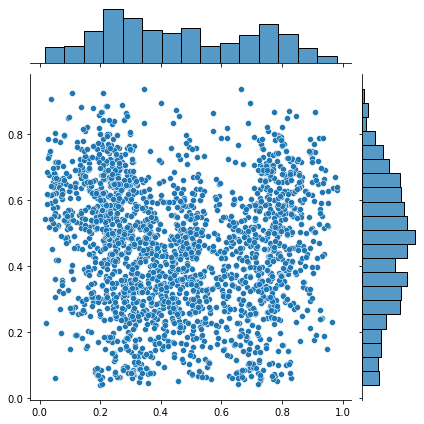

Class 10


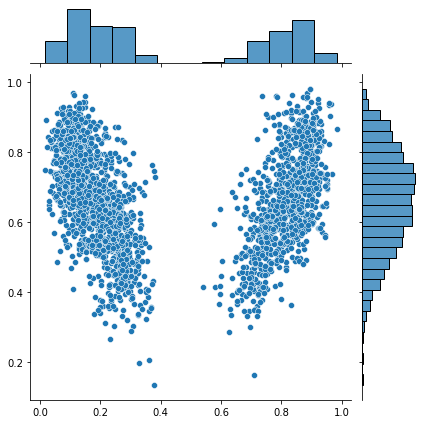

Class 11


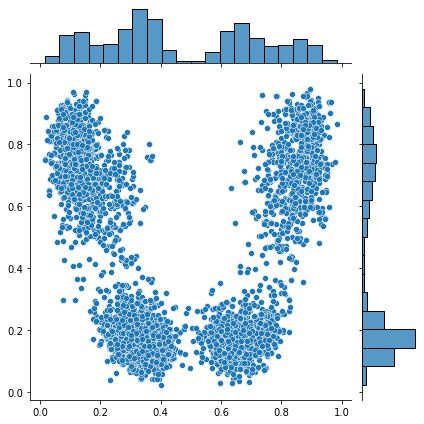

Class 12


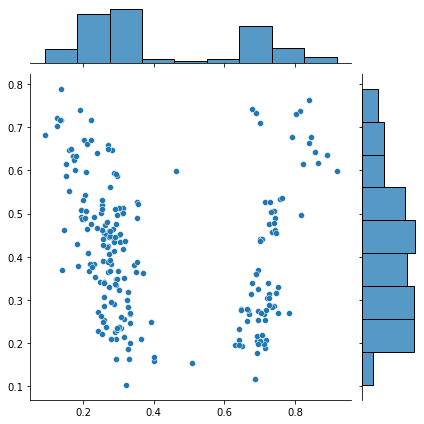

Class 13


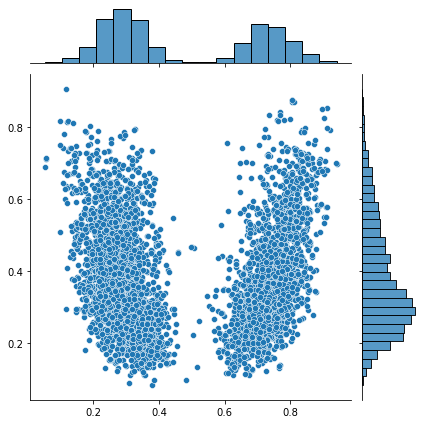

In [49]:
for i in range(14):
    print('Class', i)
    tmp = data[data['class_id'] == f'{i}']
    sns.jointplot(x=(tmp.x_max + tmp.x_min) / 2, y=(tmp.y_max + tmp.y_min) / 2)
    plt.show()